In [1]:
import numpy as np
import pandas as pd
import time
import pickle
import warnings
from tqdm import tqdm

import matplotlib.pyplot as plt
import seaborn as sns

import torch
from torch.utils.data import DataLoader
from torch import nn, optim
from torch.nn import functional as F

from structure.data import HMM_Data
from structure.model import ConvNet
from structure.pattern import PatternMatching
from structure.graphics import visualize_secondary_structure
from structure.utils import *
from structure.data_extraction import from_fasta_to_df, from_df_to_fasta

from pgm.data import AlignedSequencesData
from pgm.layers import GaussianLayer, OneHotLayer, BernoulliLayer
from pgm.edge import Edge
from pgm.model import MRF
from pgm.metrics import CD_loss, aa_acc, l1b_reg, msa_mean, ZeroSumGauge

torch.cuda.is_available()
warnings.filterwarnings("ignore")

In [2]:
AMINO_ACIDS = 'ACDEFGHIKLMNPQRSTVWY'
DATA = "/home/cyril/Documents/These/data/"
DATASET = "PF00397"

batch_size = 300
q = 21
N = 31
k = 10
lamb_l1b = 0.5
gamma = lamb_l1b/(2*q*N)

## SS3 prediction

In [3]:
class HMM_Data(object):
    def __init__(self, file):
        self.primary, self.ss3 = [], []
        data = pickle.load(open(file, 'rb'))
        self.primary = [p[:,:50] for p in data.values()]

    def __len__(self):
        return len(self.primary)
    
    def __getitem__(self, i):
        return self.primary[i]
    
def predict():
    mean_ss3_acc, mean_ss8_acc, n_res = 0,0,0
    model.eval()
#     denoiser.eval()
    predictions = []
    for batch_idx, data in enumerate(loader):
#         if batch_idx == 300:
#             break
        x = data.float().permute(0, 2, 1).to(device)[:,:40]
        B,_,N = x.size()

        optimizer.zero_grad()
        p_other, p_ss8, p_ss3 = model(x)
        p_other, p_ss8, p_ss3 = p_other.cpu(), p_ss8.cpu(), p_ss3.cpu()
        x = x.cpu()
        
        p_ss3 = F.softmax(p_ss3,1)
        p_ss8 = F.softmax(p_ss8,1)
        predictions.append(p_ss3[0].permute(1,0).detach().numpy())

    return predictions

In [4]:
dataset = HMM_Data(f"{DATA}/{DATASET}/hmm.pkl")
loader = DataLoader(dataset, batch_size = 1,
                        shuffle=False, drop_last=False)

In [ ]:
N, qx, qs, h = 128, 40, 3, 8
# del model
device = torch.device('cuda')

# del model
model = ConvNet(qx, qs)
model = model.to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)
model.load_state_dict(torch.load(f"{DATA}/secondary_structure/model_40feats.h5"))
start = time.time()

model

In [ ]:
ss_prediction = predict()
keys = pickle.load(open(f"{DATA}/{DATASET}/keys.pkl","rb"))
pickle.dump({k:v for k,v in zip(keys,ss_prediction)}, open(f"{DATA}/{DATASET}/ss3.pkl", "wb"))

## Pattern Matching

In [5]:
n_patterns, c_patterns, _ =  pickle.load(open(f"{DATA}/{DATASET}/patterns.pkl","rb"))
regexes = []
for x in n_patterns:
    if len(x):
        regexes.append([(i,None,None) for i in x])
Q,T,pi = pickle.load(open(f"{DATA}/secondary_structure/statistics.pkl", "rb"))
matcher = [PatternMatching(pattern = regex, 
                            Q = Q, T = T, pi = pi,
                            name = name, 
                            MAX_SIZE = 100) for regex, name in zip(regexes, c_patterns)][0]

In [6]:
data = pickle.load(open(f"{DATA}/{DATASET}/ss3.pkl","rb"))

In [7]:
costs = []
costs2 = dict()
ss = dict()
transitions = dict()
len_pat = len(matcher.pattern)
for j, k in tqdm(enumerate(data.keys())):
#     for j, (k,v) in enumerate(ss3_dict.items()):
#         print(f"Step {i}/{len(matchers)} : [{int(100*j/len(data))}%]", end="\r")
    sample = torch.tensor(data[k])
    N = sample.shape[0]
    p, ll, a, b, P ,Q = matcher.match(sample)
    transition = a[:-1].view(len_pat,-1,1)+b[1:].view(len_pat,1,-1)+P[0, matcher.pattern]+Q[0, matcher.pattern]-a[-1,-1]
    transitions[k] = transition
    costs2[k] = (ll,a[-1,-1])
    ss[k] = p

#         p = []
#         for i in range(transition.size(1)-1):
#             p.append(torch.exp(transition[:,:i+1,i+1:]).sum(2).sum(1).view(-1, 1))
#         p = torch.cat(p,1)

#         q = []
#         for j in range(3):
#             idx = torch.where(torch.tensor(matcher.pattern) == j)
#             q.append(p[idx].sum(0).view(-1,1))
#         q=torch.cat(q,1)
#         costs.append(q)
#         if i == 0:
#             costs.append((k,k[0],df.loc[k].folding,-ll.item(), df.loc[k].mean_id))
#         else:
#             a,b,c,d,e = costs[j]
#             d = min(d, -ll.item())
#             costs[j] = (a,b,c,d,e)
#         visualize_secondary_structure(np.array(["abc"[x] for x in p]), 0, 100)
#         plt.title(f"Sample {j} : {ll:.3f} ({time_ms} ms)")

for k, t in transitions.items():
    t = t - torch.log(torch.exp(t).sum(2).sum(1)).view(-1,1,1)
    tr = []
    for i in range(10):
        tr.append(np.trace(torch.exp(t).numpy(), offset = i, axis1 = 1, axis2 = 2))
    tr = np.array(tr).T
    transitions[k] = tr.argmax(1)

9904it [00:42, 231.16it/s]


In [8]:
AMINO_ACIDS = '-ACDEFGHIKLMNPQRSTVWY'
AA_IDS = {l: i for i, l in enumerate(AMINO_ACIDS)}

In [9]:
class AlignedSequencesData(object):
    def __init__(self, file):
        self.df = from_fasta_to_df(file)
        raw_sequences = np.array(list(self.df["aligned_seq"].apply(lambda s: np.array([AA_IDS[c] if c in AA_IDS.keys() else -1 for c in s]))))
        ss_sequences = np.zeros(raw_sequences.shape)
        for i,(x,s) in tqdm(enumerate(zip(raw_sequences,ss.values()))):
            idx = np.where(x > 0)[0]
            ss_sequences[i,idx] = s.numpy()+1
#         ss_sequences = np.zeros((raw_sequences.shape[0],7))
#         for i,(x,s) in tqdm(enumerate(zip(raw_sequences,transitions.values()))):
#             ss_sequences[i] = s

        idx = ((raw_sequences == -1).max(0) == False)
        raw_sequences = raw_sequences[:, idx] 
        ss_sequences = ss_sequences[:, idx] 
        ss_sequences = np.array(ss_sequences, dtype=int)

        raw_sequences = [to_onehot(seq, (None, len(AA_IDS))) for seq in raw_sequences]
        ss_sequences = [to_onehot(seq, (None, 4)) for seq in ss_sequences]
#         ss_sequences = [to_onehot(seq, (None, 10)) for seq in ss_sequences]
        self.weights = np.ones(len(self.df.values))
        self.raw_sequences, self.ss_sequences = np.array(raw_sequences), np.array(ss_sequences)
        
    def __len__(self):
        return len(self.raw_sequences)
    
    def __getitem__(self, i):
        return self.raw_sequences[i], self.ss_sequences[i], self.weights[i]

In [10]:
filename = "aligned.fasta"
train_dataset = AlignedSequencesData(f"{DATA}/{DATASET}/{filename}")
train_loader = DataLoader(train_dataset, batch_size = batch_size, 
                          shuffle = True, drop_last=True)

9904it [00:00, 25411.35it/s]


In [11]:
device = torch.device('cpu')

In [12]:
pots = np.zeros((31, 21))
for w, v in zip(train_dataset.weights,train_dataset.raw_sequences):
    pots += w*v
pots /= np.sum(train_dataset.weights)
pots = pots.T
pots = torch.FloatTensor((pots.T-np.mean(pots, 1)).T).view(-1).to(device)

In [13]:
pots2 = np.zeros((31, 4))
for w, v in zip(train_dataset.weights,train_dataset.ss_sequences):
    pots2 += w*v
pots2 /= np.sum(train_dataset.weights)
pots2 = pots2.T
pots2 = torch.FloatTensor((pots2.T-np.mean(pots2, 1)).T).view(-1).to(device)

## RBM

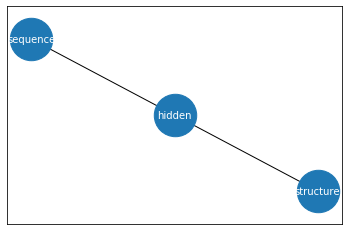

In [14]:
v = OneHotLayer(pots, N = 31, q = 21, name = "sequence")
s = OneHotLayer(pots2, N = 31, q = 4, name = "structure")
h = GaussianLayer(N = 200, name = "hidden")

E = [(v.name, h.name), 
     (s.name, h.name)
    ]

model = MRF(layers = {v.name: v, 
                      s.name: s, 
                      h.name: h},
            edges = E).to(device)

optimizer = optim.Adam(model.parameters(), lr=0.001)

In [23]:
torch.save(model.state_dict(), f"{DATA}/rbm/model_sec_structure.h5")

In [ ]:
start = time.time()
model.train()
in_lays, out_lays = ["sequence", "structure"], ["hidden"]
edge1 = model.edges[("sequence", "hidden")]
edge2 = model.edges[("structure", "hidden")]


for epoch in range(6000):
    mean_loss, mean_reg, mean_acc = 0, 0, 0
    for batch_idx, data in enumerate(train_loader):
        x = data[0].float().permute(0, 2, 1).to(device)
        ss = data[1].float().permute(0, 2, 1).to(device)
        w = data[2].float().to(device)
        
        # Sampling
        d_0 = {"sequence":x, "structure":ss}
        d_0, d_f = model.gibbs_sampling(d_0, in_lays, out_lays, k = 1)
        
        # Optimization
        optimizer.zero_grad()
        cd_loss = CD_loss(model, d_0, d_f, w)
        reg = 4*l1b_reg(edge1) + l1b_reg(edge2)
        loss = msa_mean(cd_loss, w) + gamma * reg
        acc = aa_acc(d_0["sequence"].view(*x.size()), d_f["sequence"].view(*x.size()))
        loss.backward()
        optimizer.step()
        
        # Metrics
        mean_loss = (mean_loss*batch_idx + msa_mean(cd_loss, w))/ (batch_idx+1)
        mean_reg = (mean_reg*batch_idx - gamma*reg)/(batch_idx+1)
        mean_acc = (mean_acc*batch_idx + acc)/(batch_idx+1)
        m, s = int(time.time()-start)//60, int(time.time()-start)%60
        print(f'''Train Epoch: {epoch} [{int(100*batch_idx/len(train_loader))}%] || Time: {m} min {s} || Loss: {mean_loss:.3f} || Reg: {mean_reg:.3f} || Acc: {mean_acc:.3f}''', end="\r")
    if not epoch % 20:
        print(f'''Train Epoch: {epoch} [100%] || Time: {m} min {s} || Loss: {mean_loss:.3f} || Reg: {mean_reg:.3f} || Acc: {mean_acc:.3f}''')
#     if not epoch % 50:
#         data = next(iter(val_loader))
#         x = data[0].float().permute(0, 2, 1).to(device)
#         x_f, _, mut, _ = edge.gibbs_step(x, sample=False)
#         acc = aa_acc(x, mut.view(batch_size, q, N))
#         m, s = int(time.time()-start)//60, int(time.time()-start)%60
#         print(f'''Val: {epoch} || Time: {m} min {s} || Loss: {mean_loss:.2f} || Reg: {mean_reg:.2f} || Acc: {mean_acc:.2f} ||  Val Acc : {acc:.3f}''')

Train Epoch: 0 [100%] || Time: 0 min 0 || Loss: 0.412 || Reg: -4.098 || Acc: 0.580
Train Epoch: 20 [100%] || Time: 0 min 23 || Loss: 0.040 || Reg: -4.123 || Acc: 0.581
Train Epoch: 40 [100%] || Time: 0 min 46 || Loss: -0.470 || Reg: -4.118 || Acc: 0.581
Train Epoch: 60 [100%] || Time: 1 min 11 || Loss: 0.003 || Reg: -4.121 || Acc: 0.580
Train Epoch: 80 [100%] || Time: 1 min 38 || Loss: 0.684 || Reg: -4.107 || Acc: 0.582
Train Epoch: 100 [100%] || Time: 2 min 6 || Loss: -0.225 || Reg: -4.117 || Acc: 0.582
Train Epoch: 120 [100%] || Time: 2 min 32 || Loss: 0.243 || Reg: -4.123 || Acc: 0.581
Train Epoch: 140 [100%] || Time: 3 min 2 || Loss: 0.481 || Reg: -4.115 || Acc: 0.5822
Train Epoch: 160 [100%] || Time: 3 min 28 || Loss: -0.674 || Reg: -4.092 || Acc: 0.581
Train Epoch: 180 [100%] || Time: 3 min 54 || Loss: 0.003 || Reg: -4.117 || Acc: 0.582
Train Epoch: 200 [100%] || Time: 4 min 21 || Loss: -1.126 || Reg: -4.098 || Acc: 0.582
Train Epoch: 220 [100%] || Time: 4 min 51 || Loss: -0.199 

### Secondary Structure

In [1]:
import shap

ModuleNotFoundError: No module named 'shap'

In [20]:
import importlib
importlib.reload(structure_logo)

<module 'structure_logo' from '/home/cyril/Documents/These/paper_codes/PGM3/utilities/structure_logo.py'>

In [16]:
import sys

ROOT = "/home/cyril/Documents/These"
sys.path.append(f"{ROOT}/paper_codes/PGM3/source/")
sys.path.append(f"{ROOT}/paper_codes/PGM3/utilities/")

import Proteins_utils, sequence_logo, structure_logo, utilities10 as utilities, sequence_logo, structure_logo, plots_utils

def get_beta(W,include_gaps=False):
    if not include_gaps:
        W_ = W[:,:,:-1]
    else:
        W_ = W
    return  np.sqrt( (W_**2).sum(-1).sum(-1) ).numpy()

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


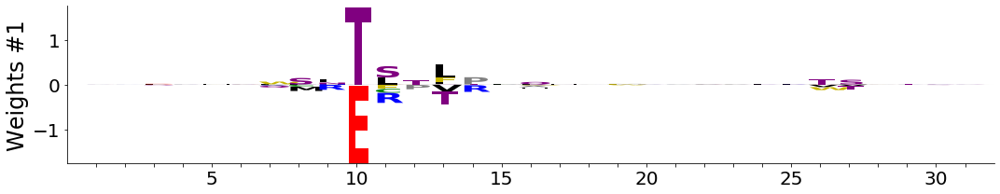

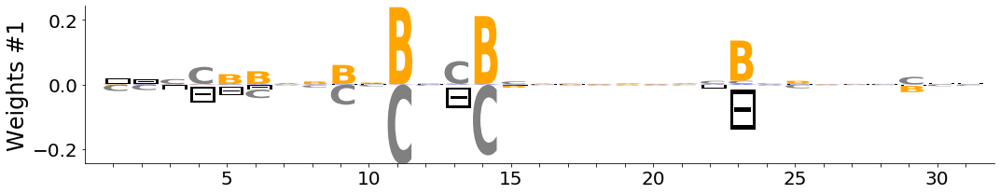

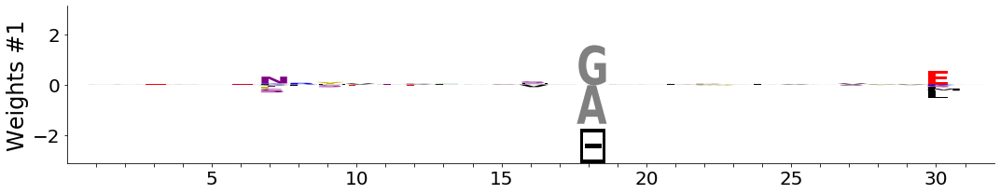

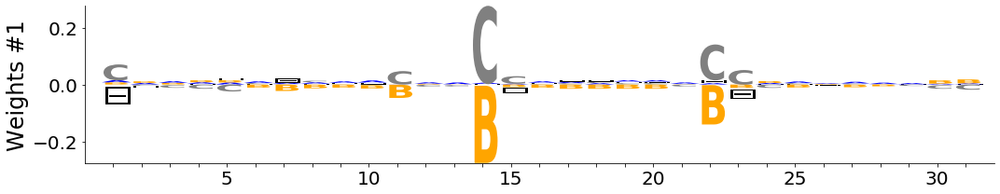

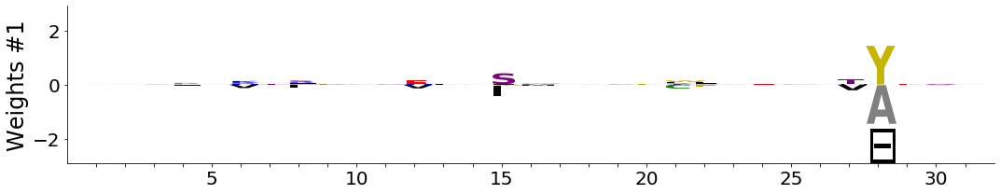

...

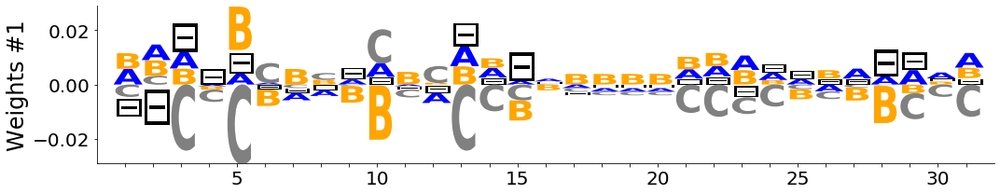

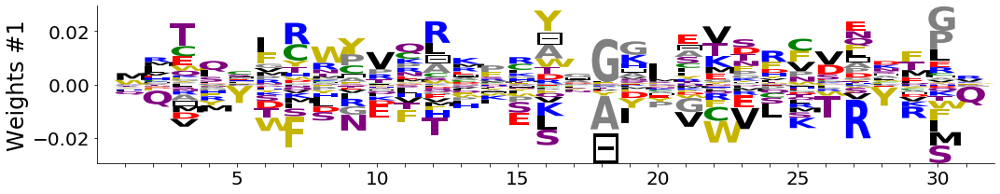

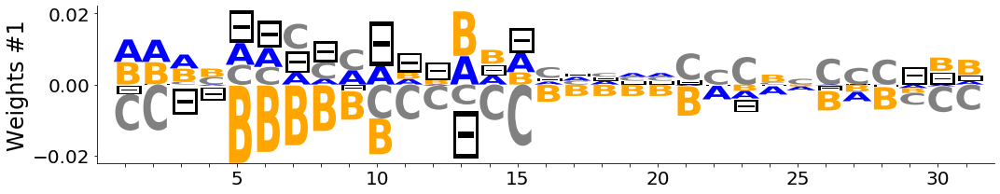

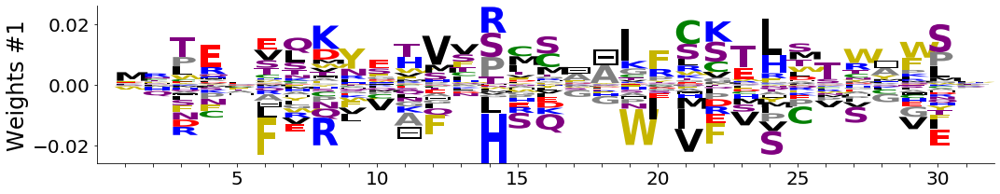

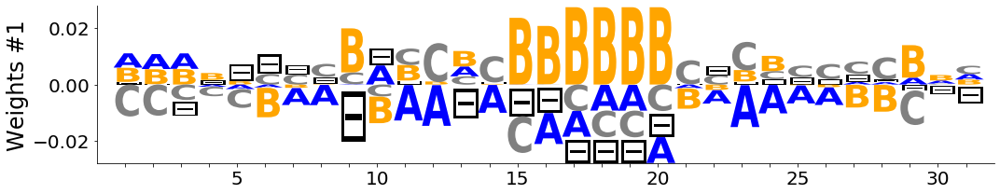

In [21]:
max_acti = model.edges[("sequence", "hidden")].get_weights().detach().view(-1, 21, 31).permute(0,2,1)
max_acti[:,:,0], max_acti[:,:,-1] = max_acti[:,:,-1], max_acti[:,:,0]
max_acti2 = model.edges[("structure", "hidden")].get_weights().detach().view(-1, 4, 31).permute(0,2,1)

order = np.argsort(get_beta(max_acti))[::-1]
for i in order:
    sequence_logo.Sequence_logo_multiple(max_acti.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)
    structure_logo.Sequence_logo_multiple(max_acti2.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)

### Secondary structure length

In [21]:
import sys

ROOT = "/home/cyril/Documents/These"
sys.path.append(f"{ROOT}/paper_codes/PGM3/source/")
sys.path.append(f"{ROOT}/paper_codes/PGM3/utilities/")

import Proteins_utils, sequence_logo, structure_logo, utilities10 as utilities, sequence_logo, structure_logo, plots_utils

def get_beta(W,include_gaps=False):
    if not include_gaps:
        W_ = W[:,:,:-1]
    else:
        W_ = W
    return  np.sqrt( (W_**2).sum(-1).sum(-1) ).numpy()

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


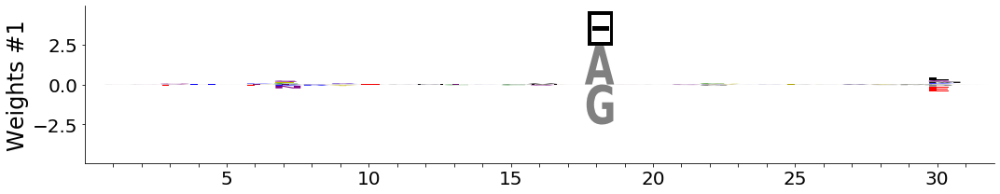

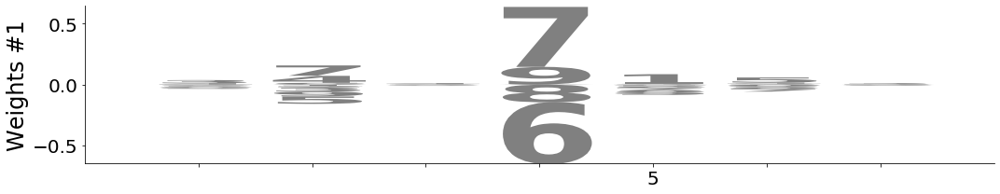

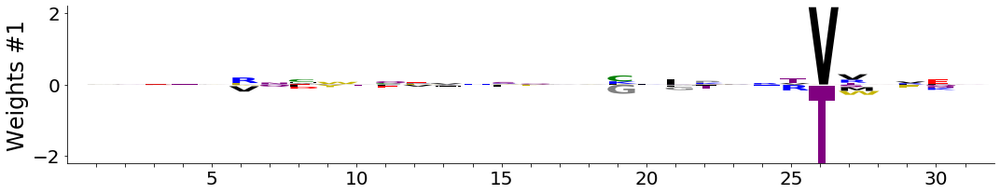

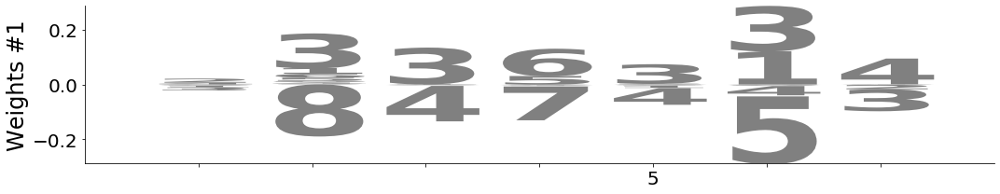

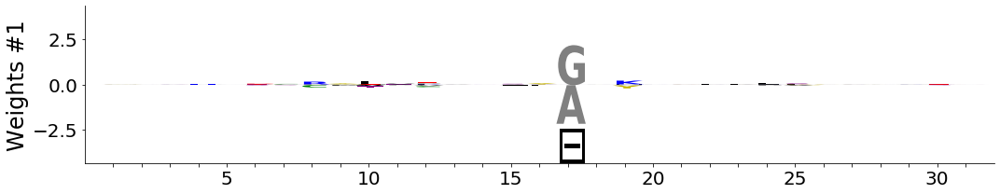

...

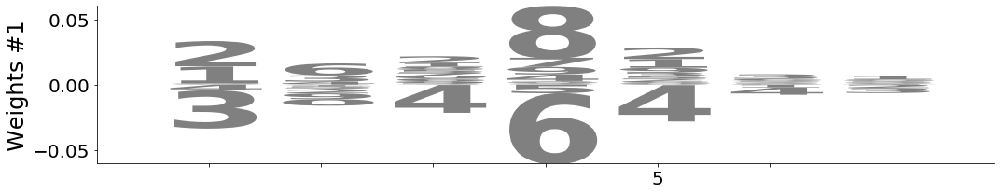

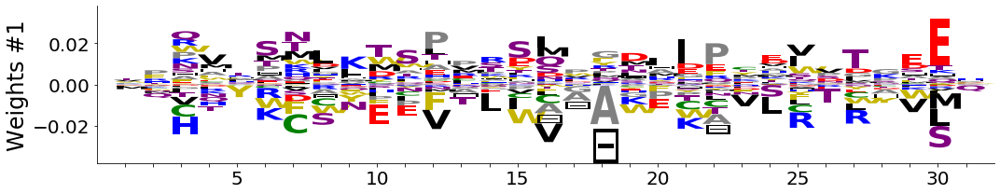

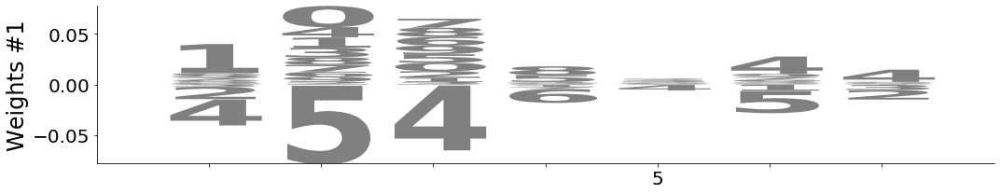

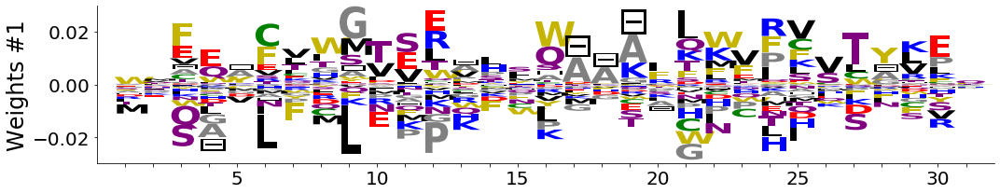

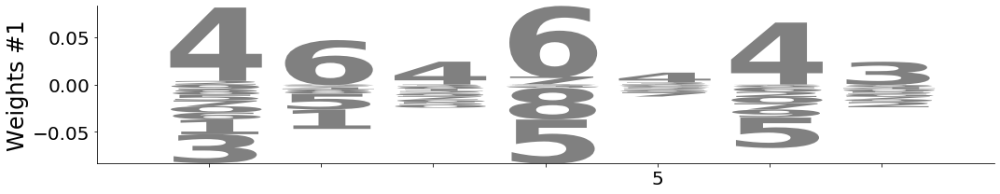

In [22]:
max_acti = model.edges[("sequence", "hidden")].get_weights().detach().view(-1, 21, 31).permute(0,2,1)
max_acti[:,:,0], max_acti[:,:,-1] = max_acti[:,:,-1], max_acti[:,:,0]
max_acti2 = model.edges[("structure", "hidden")].get_weights().detach().view(-1, 10, 7).permute(0,2,1)

order = np.argsort(get_beta(max_acti))[::-1]
for i in order:
    sequence_logo.Sequence_logo_multiple(max_acti.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)
    structure_logo.Sequence_logo_multiple(max_acti2.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)